So far I have found that the NWP are not very good at nowcasting the PV yield. I found that they are only just better than using location and time of day and year alone. This is a surprise as they seem to have lot of relevant variables in them such as cloud cover, downward shortwave radiation and temperature. 

The satellite imagery performs much better and I just am having trouble believing there could be such a big difference between them. Therefore in this notebook I want to verify that the data which the developed batch selector is sampling is in fact correct. I have no reason to believe it isn't other than the surprising lack of predictability.

In [16]:
import xarray as xr
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import shapely.geometry as sgeom

import time
import glob
import json
import os

from sklearn.utils import shuffle 

import src

In [2]:
pv_metadata_df = src.data.load_pv.load_pv_metadata("~/repos/predict_pv_yield/data/"+src.data.load_pv.PV_METADATA_FILEPATH)

In [3]:
pv_power_df = src.data.load_pv.load_pv_power(filepath="~/repos/predict_pv_yield/data/"+src.data.load_pv.PV_DATA_FILEPATH, 
                                             start='2018-01-01', end='2019-12-31')

In [4]:
pv_power_df = pv_power_df.dropna(axis=0, how='all')

In [5]:
pv_power_df.head()

,690,709,794,973,1364,1556,1627,1646,1647,1872,...,68000,68212,68218,68219,68303,68324,68404,68443,68800,68846
datetime,,,,,,,,,,,,,,,,,,,,,
2018-01-01 03:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:35:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:45:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:50:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Drop systems (in-place) without PV data and metadata
src.features.preprocessing.filter_to_power_metadata_match(pv_metadata_df, pv_power_df)

In [7]:
# make clearsky GHI object
latitude, longitude = pv_metadata_df.loc[pv_power_df.columns, ['latitude', 'longitude']].values.T
ghiscalar = src.features.transformers.ClearskyScalar(latitude, longitude, g0=10)

# filter data to daylight hours (in-place)
ghiscalar.filter_to_daylight(pv_power_df, min_ghi=20, inplace=True)

In [8]:
# drop systems with no daylight
pv_power_df = pv_power_df.dropna(axis=0, how='all')
src.features.preprocessing.filter_to_power_metadata_match(pv_metadata_df, pv_power_df)

In [9]:
# scale by max power output
rminmax = src.features.transformers.RobustMinMaxScaler(saturation_fraction=0.01)
pv_prop_max_df = rminmax.fit_transform(pv_power_df)

In [10]:
nwp_channels = ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf', 'si10', 'wdir10']

In [11]:
# set up NWP loader with some obvious seeming channels (this takes a minute or two)
nwploader = src.data.nwp_loader.NWPLoader(height=144000, width=144000, channels=nwp_channels)

In [12]:
sat_channels = src.data.sat_loader.DEFAULT_CHANNELS
sat_channels

['VIS006',
 'VIS008',
 'IR_016',
 'IR_039',
 'WV_062',
 'WV_073',
 'IR_087',
 'IR_097',
 'IR_108',
 'IR_120',
 'IR_134',
 'HRV']

In [13]:
# set up sat loader with high resolutipon visual and a couple of infrared channels
satloader = src.data.sat_loader.SatelliteLoader(height=144000, width=144000, channels=sat_channels)

In [17]:
from src.data.constants import NORTH, SOUTH, EAST, WEST

class UKVDomain(ccrs.OSGB):
    """The geographical domain of the UK Met Office UKV model."""
    
    @property
    def x_limits(self):
        return (WEST, EAST)
    
    @property
    def y_limits(self):
        return (SOUTH, NORTH)
    
    @property
    def boundary(self):
        return sgeom.LineString([
            (WEST, SOUTH), 
            (WEST, NORTH), 
            (EAST, NORTH), 
            (EAST, SOUTH), 
            (WEST, SOUTH)])

In [18]:
satloader.dataset

,Array,Chunk
Bytes,3.02 TB,18.52 MB
Shape,"(12, 163137, 704, 548)","(12, 1, 704, 548)"
Count,652549 Tasks,163137 Chunks
Type,float32,numpy.ndarray


In [19]:
nwploader.dataset

,Array,Chunk
Bytes,310.72 GB,15.43 MB
Shape,"(5442, 37, 704, 548)","(1, 10, 704, 548)"
Count,49244 Tasks,21768 Chunks
Type,float32,numpy.ndarray


In [30]:
ds.y

<xarray.DataArray 'y' (y: 704)>
array([1222000., 1220000., 1218000., ..., -180000., -182000., -184000.])
Coordinates:
  * y        (y) float64 1.222e+06 1.22e+06 1.218e+06 ... -1.82e+05 -1.84e+05
    time     datetime64[ns] 2018-01-13T12:00:00
    step     timedelta64[ns] 00:00:00

I may have just found a mistake. The y-axis for the NWP seems to have been put in upside down.

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: The default value for the *approx* keyword argument to OSGB will change from True to False after 0.18.
  after removing the cwd from sys.path.


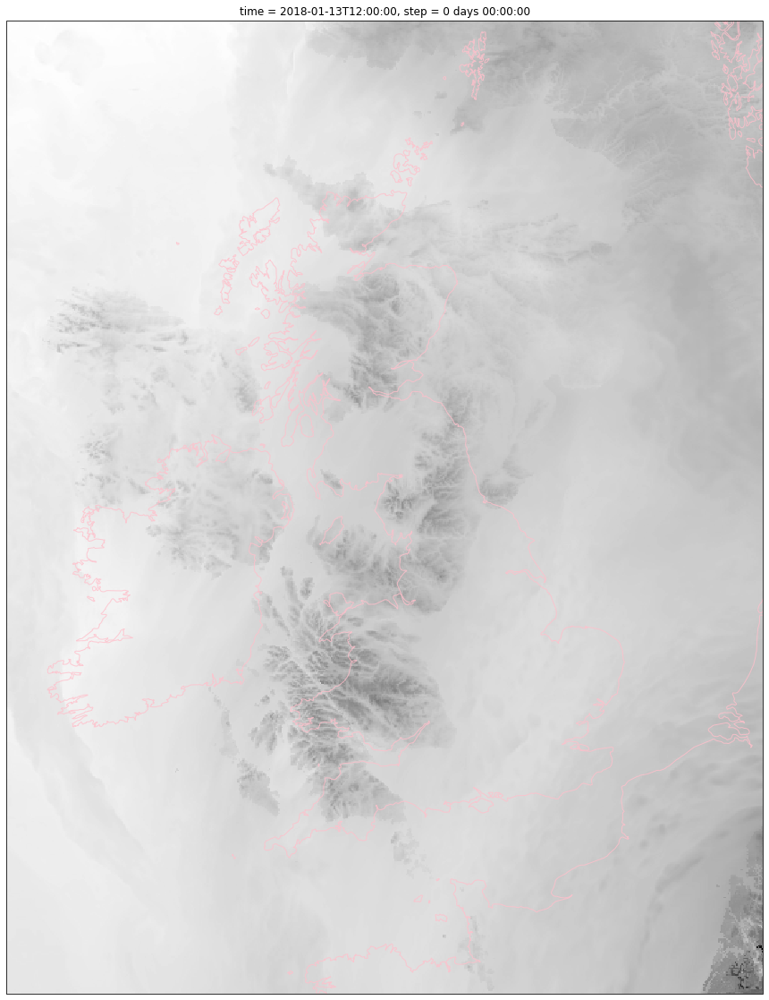

In [35]:
ds = nwploader.dataset['t'].isel(time=100, step=0).load()

fig = plt.figure(figsize=(20, 20))
ax = plt.axes(projection=UKVDomain())
ax.coastlines(resolution='10m', alpha=0.8, color='pink')

ds.plot.imshow(ax=ax, cmap='gray', add_colorbar=False);

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: The default value for the *approx* keyword argument to OSGB will change from True to False after 0.18.
  


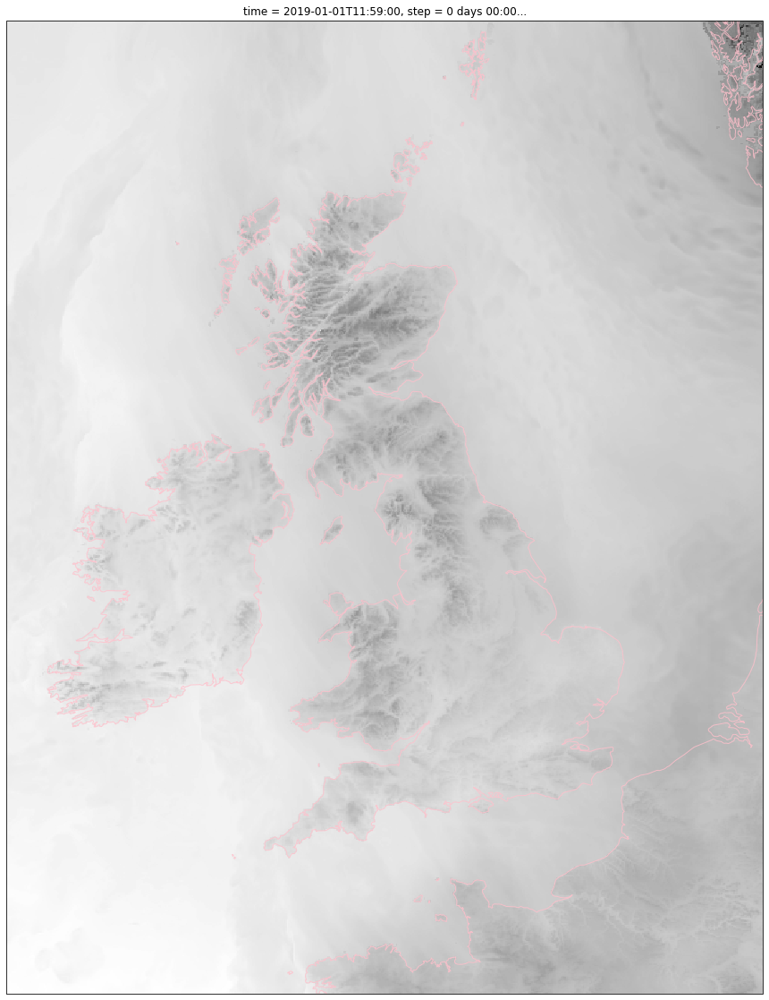

In [95]:
da = nwploader.dataset['t'].isel(time=100, step=0).load()
# flip the y-axis
da['y'] = ds.y.sel(y=slice(None,None, -1))

fig = plt.figure(figsize=(20, 20))
ax = plt.axes(projection=UKVDomain())
ax.coastlines(resolution='10m', alpha=0.8, color='pink')

da.plot.imshow(ax=ax, cmap='gray', add_colorbar=False);

Going to reverse this and upload the corrected y data to the GCP store

In [ ]:
import zarr
ds = da.to_dataset()

encoding = { var_name: {
        'filters': [zarr.Delta(dtype='float32')],
        'compressor': zarr.Blosc(cname='zstd', 
                                 clevel=4, 
                                 shuffle=zarr.Blosc.AUTOSHUFFLE)}
            for var_name in ds.keys()}

ds.to_zarr(os.path.expanduser("~/tmp/corrected_nwp_y_zarr"), consolidated=True, encoding=encoding)

In [114]:
import json
import subprocess
import os

Check if the excoding is the same

In [104]:
with open(os.path.expanduser("~/tmp/corrected_nwp_y_zarr/.zmetadata"), "r") as f:
    local_zmeta = json.load(f)

In [105]:
def decode_command(command_string, split=True):
    command_list = command_string.split(' ')
    out = subprocess.Popen(command_list,
                           stdout=subprocess.PIPE, 
                           stderr=subprocess.STDOUT)
    stdout, _ = out.communicate()
    result = stdout.decode()
    if split:
        result = result.split('\n')
        result = [r for r in result if r!='']
    return result

def get_gsutil_json(gspath):
    return json.loads(decode_command(f"gsutil cat {gspath}", split=False))

In [106]:
gsp_zmetas = [get_gsutil_json(f"gs://solar-pv-nowcasting-data/NWP/UK_Met_Office/UKV_zarr/{subdir}/.zmetadata")
                  for subdir in ["2018_1-6", "2018_7-12", "2019_1-6", "2019_7-12"]]

In [113]:
[local_zmeta['metadata']['y/.zarray']==gsp_zmeta['metadata']['y/.zarray'] for gsp_zmeta in gsp_zmetas]

[True, True, True, True]

Encodings are the same (so compatible) and we can just upload the corrected y data.

Take a copy of the original y data just in case

In [117]:
os.makedir(os.path.expanduser("~/tmp/old_y_stash"))
os.system("gsutil cp gs://solar-pv-nowcasting-data/NWP/UK_Met_Office/UKV_zarr/2018_1-6/y/0 ~/tmp/old_y_stash/0")

0

In [118]:
for subdir in ["2018_1-6", "2018_7-12", "2019_1-6", "2019_7-12"]:
    os.system(f"gsutil cp ~/tmp/corrected_nwp_y_zarr/y/0 gs://solar-pv-nowcasting-data/NWP/UK_Met_Office/UKV_zarr/{subdir}/y/0")

Check if it has worked

In [121]:
del nwploader

nwploader = src.data.nwp_loader.NWPLoader(height=144000, width=144000, channels=nwp_channels[0])

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: The default value for the *approx* keyword argument to OSGB will change from True to False after 0.18.
  after removing the cwd from sys.path.


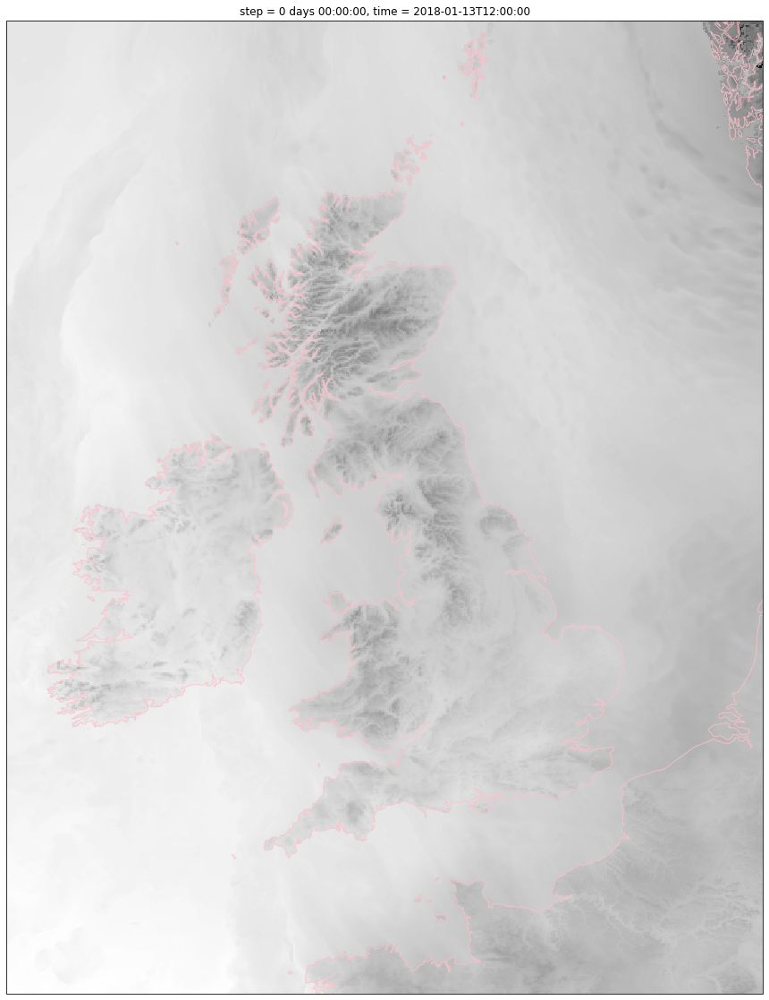

In [123]:
da = nwploader.dataset.isel(time=100, step=0).load()

fig = plt.figure(figsize=(20, 20))
ax = plt.axes(projection=UKVDomain())
ax.coastlines(resolution='10m', alpha=0.8, color='pink')

da.plot.imshow(ax=ax, cmap='gray', add_colorbar=False);

In [124]:
nwploader.dataset

,Array,Chunk
Bytes,310.72 GB,15.43 MB
Shape,"(5442, 37, 704, 548)","(1, 10, 704, 548)"
Count,49244 Tasks,21768 Chunks
Type,float32,numpy.ndarray


Looks like it's fixed

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: The default value for the *approx* keyword argument to OSGB will change from True to False after 0.18.
  after removing the cwd from sys.path.


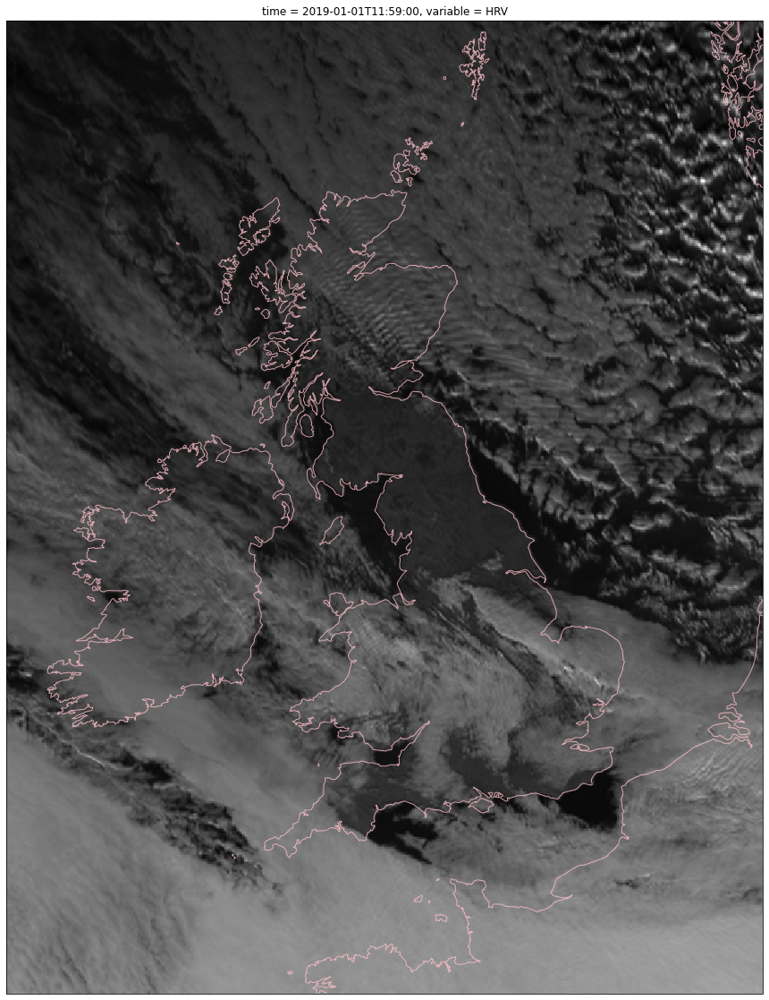

In [125]:
ds = satloader.dataset['stacked_eumetsat_data'].sel(variable='HRV', time='2019-01-01 11:59').load()

fig = plt.figure(figsize=(20, 20))
ax = plt.axes(projection=UKVDomain())
ax.coastlines(resolution='10m', alpha=0.8, color='pink')

ds.plot.imshow(ax=ax, cmap='gray', add_colorbar=False);